In [1]:
%reload_ext autoreload
%autoreload 2

2024-09-25 15:10:21.846704: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-25 15:10:21.932656: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-25 15:10:21.971826: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-25 15:10:21.983225: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-25 15:10:22.038855: I tensorflow/core/platform/cpu_feature_guar

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


I0000 00:00:1727298625.297129    3676 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-09-25 15:10:25.400023: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2343] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Number of batches of 32 images train_ds: 250
Number of batches of 32 images validation_ds: 32
Number of batches of 32 images test_ds: 32


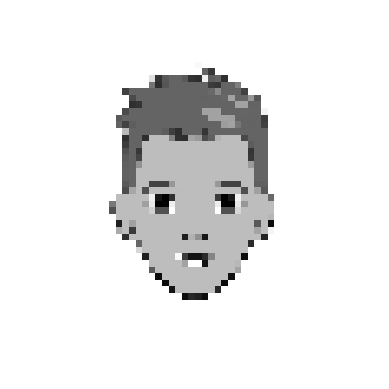

In [2]:
import generacion_cartoon.utils.paths as path
import notebooks.drac_CVAE_modified as CVAE
import tensorflow as tf
import imageio
import tensorflow_probability as tfp
%run "../generacion_cartoon/data/0.1-drac-make_dataset.ipynb"
import time
import numpy as np
import glob


In [3]:
print("GPUs disponibles:", len(tf.config.list_physical_devices('GPU')))

GPUs disponibles: 0


In [4]:
tf.debugging.set_log_device_placement(True)


In [5]:
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

In [6]:
print("Dispositivos disponibles:")
for device in tf.config.list_physical_devices():
    print(device)


Dispositivos disponibles:
PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')


In [7]:
def plot_latent_images(model, num_images_x, epoch, im_size=56, save=True, first_epoch=False, f_ep_count=0):
    
    # Create image matrix 
    image_width = im_size*num_images_x
    image_height = image_width
    image = np.zeros((image_height, image_width))

    # Create list of values which are evenly spaced wrt probability mass

    norm = tfp.distributions.Normal(0, 1)
    grid_x = norm.quantile(np.linspace(0.05, 0.95, num_images_x))
    grid_y = norm.quantile(np.linspace(0.05, 0.95, num_images_x))

    # For each point on the grid in the latent space, decode and
    # copy the image into the image array
    for i, yi in enumerate(grid_x):
        for j, xi in enumerate(grid_y):
            z = np.array([[xi, yi]])
            x_decoded = model.sample(z)
            digit = tf.reshape(x_decoded[0], (im_size, im_size))
            image[i * im_size: (i + 1) * im_size,
                  j * im_size: (j + 1) * im_size] = digit.numpy()
    

    # Plot the image array
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='Greys_r')
    plt.axis('Off')

    # Potentially save, with different formatting if within first epoch
    if save and first_epoch:
        name = 'tf_grid_at_epoch_{:04d}.{:04d}.png'.format(epoch, f_ep_count)
        plt.savefig(path.data_created_dir(name))
    elif save:
        name = 'tf_grid_at_epoch_{:04d}.png'.format(epoch)
        plt.savefig(path.data_created_dir(name))

In [8]:
import mlflow
import mlflow.tensorflow
import dagshub

In [9]:
params ={'latent_dim':2,'epochs':30, 'gamma':1.0, 'beta':1.0, 'epsilon':1e-4}
model = CVAE.CVAE(latent_dim=params['latent_dim'], gamma=params['gamma'], beta=params['beta'])

/home/dracdarktime/anaconda3/envs/generacion_cartoon/lib/python3.9/site-packages/keras/src/layers/core/input_layer.py:26: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Accessing as DRACDARKTIME

Initialized MLflow to track repo "DRACDARKTIME/VA_cartoon"

Repository DRACDARKTIME/VA_cartoon initialized!

2024-09-25 15:10:58.406914: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2024-09-25 15:10:59.187532: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch: 1, Test set ELBO: -753.733154296875, time elapse for current epoch: 26.714040517807007


2024-09-25 15:11:15.279854: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch: 2, Test set ELBO: -655.5511474609375, time elapse for current epoch: 15.117139339447021
Epoch: 3, Test set ELBO: -624.8497924804688, time elapse for current epoch: 15.301247119903564


2024-09-25 15:11:53.295479: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch: 4, Test set ELBO: -603.1678466796875, time elapse for current epoch: 15.85640025138855
Epoch: 5, Test set ELBO: -592.6181640625, time elapse for current epoch: 14.99487018585205
Epoch: 6, Test set ELBO: -589.9434814453125, time elapse for current epoch: 14.820386409759521
Epoch: 7, Test set ELBO: -586.2565307617188, time elapse for current epoch: 14.921120166778564


2024-09-25 15:13:05.240627: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch: 8, Test set ELBO: -579.44970703125, time elapse for current epoch: 14.840273380279541
Epoch: 9, Test set ELBO: -576.4107055664062, time elapse for current epoch: 14.994345426559448
Epoch: 10, Test set ELBO: -575.0631713867188, time elapse for current epoch: 14.907700061798096
Epoch: 11, Test set ELBO: -572.5128173828125, time elapse for current epoch: 14.816259622573853
Epoch: 12, Test set ELBO: -569.048095703125, time elapse for current epoch: 14.97309398651123
Epoch: 13, Test set ELBO: -564.7728881835938, time elapse for current epoch: 14.931418418884277
Epoch: 14, Test set ELBO: -565.0921630859375, time elapse for current epoch: 14.988528490066528
Epoch: 15, Test set ELBO: -561.7677612304688, time elapse for current epoch: 14.854996681213379


2024-09-25 15:15:30.001200: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch: 16, Test set ELBO: -558.6638793945312, time elapse for current epoch: 15.30400037765503
Epoch: 17, Test set ELBO: -557.8268432617188, time elapse for current epoch: 14.928709030151367


/tmp/ipykernel_3676/3165008714.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 10))


Epoch: 18, Test set ELBO: -555.4854125976562, time elapse for current epoch: 14.905679941177368
Epoch: 19, Test set ELBO: -555.7889404296875, time elapse for current epoch: 14.601383686065674
Epoch: 20, Test set ELBO: -555.239990234375, time elapse for current epoch: 14.64797306060791
Epoch: 21, Test set ELBO: -552.948486328125, time elapse for current epoch: 14.747614860534668
Epoch: 22, Test set ELBO: -550.1005859375, time elapse for current epoch: 14.596024751663208
Epoch: 23, Test set ELBO: -550.0550537109375, time elapse for current epoch: 14.828373670578003
Epoch: 24, Test set ELBO: -548.2542724609375, time elapse for current epoch: 14.570659399032593
Epoch: 25, Test set ELBO: -546.996826171875, time elapse for current epoch: 14.796157360076904
Epoch: 26, Test set ELBO: -550.8078002929688, time elapse for current epoch: 14.662623167037964
Epoch: 27, Test set ELBO: -543.525634765625, time elapse for current epoch: 14.794567823410034
Epoch: 28, Test set ELBO: -544.517333984375, tim

2024/09/25 15:19:41 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
/home/dracdarktime/anaconda3/envs/generacion_cartoon/lib/python3.9/site-packages/keras/src/saving/saving_api.py:107: UserWarning: You are saving a model that has not yet been built. It might not contain any weights yet. Consider building the model first by calling it on some data.
  return saving_lib.save_model(model, filepath)
2024/09/25 15:19:44 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: /tmp/tmp55zat57s/model, flavor: tensorflow). Fall back to return ['tensorflow==2.17.0', 'cloudpickle==3.0.0']. Set logging level to DEBUG to see the full traceback. 
2024/09/25 15:19:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please 

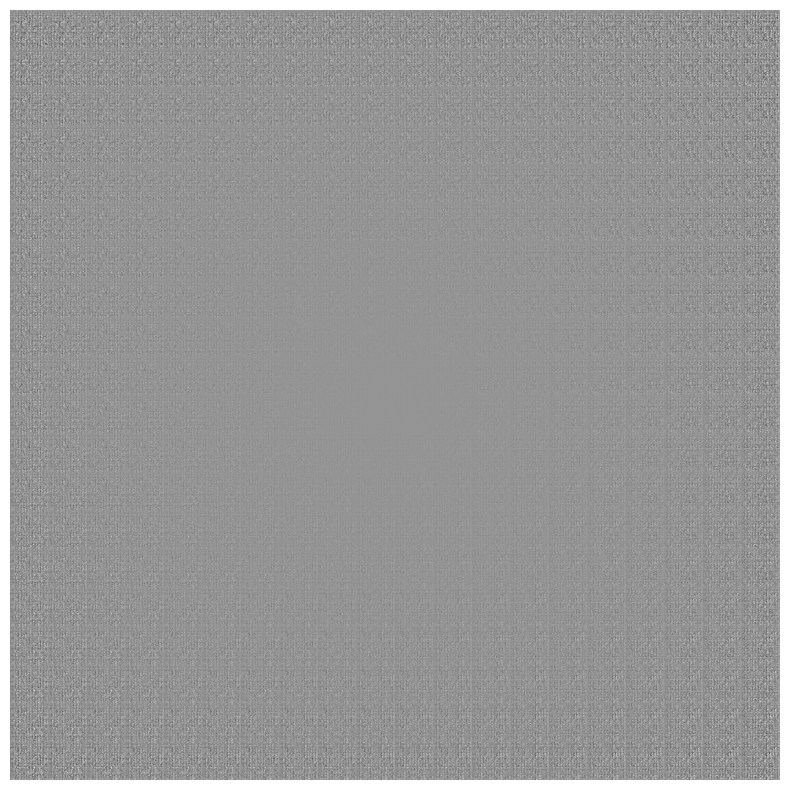

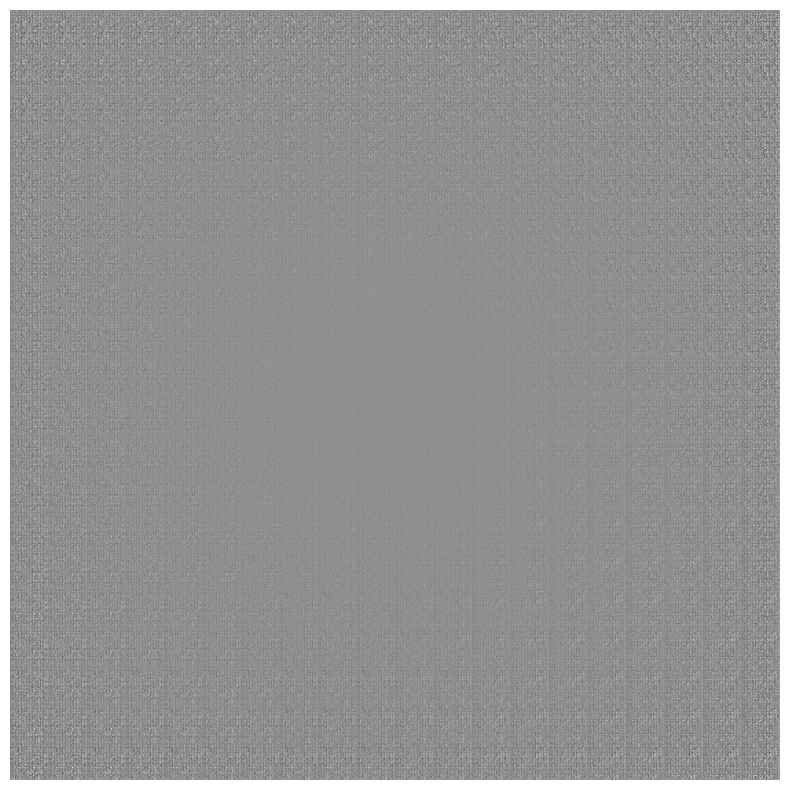

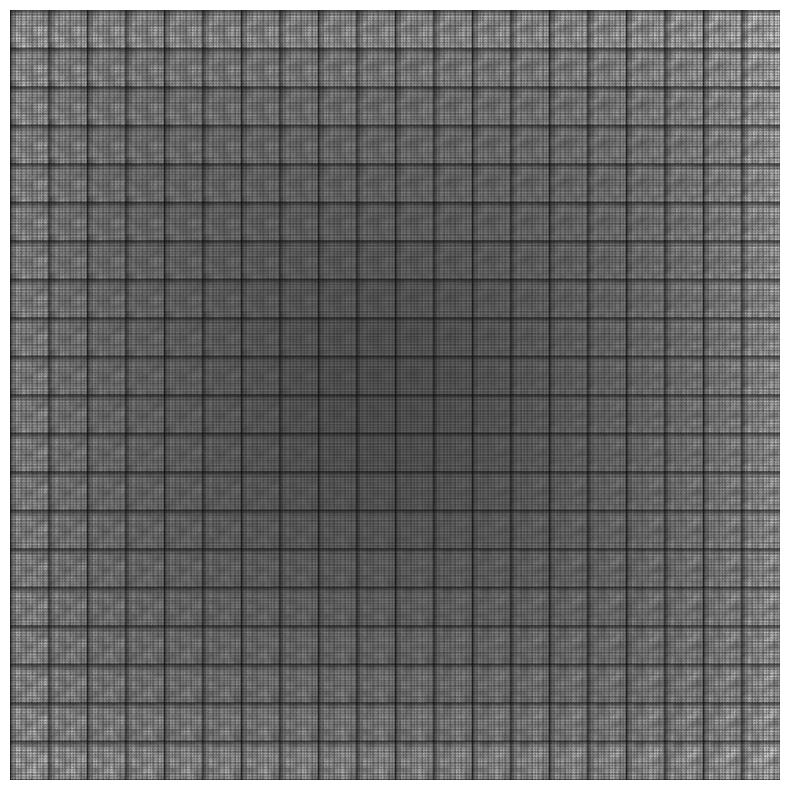

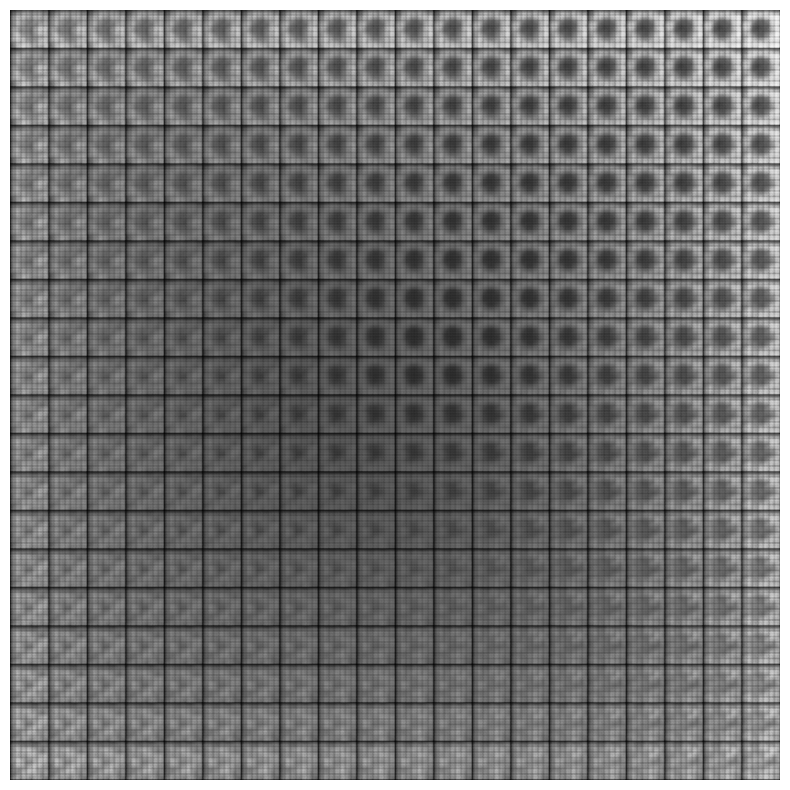

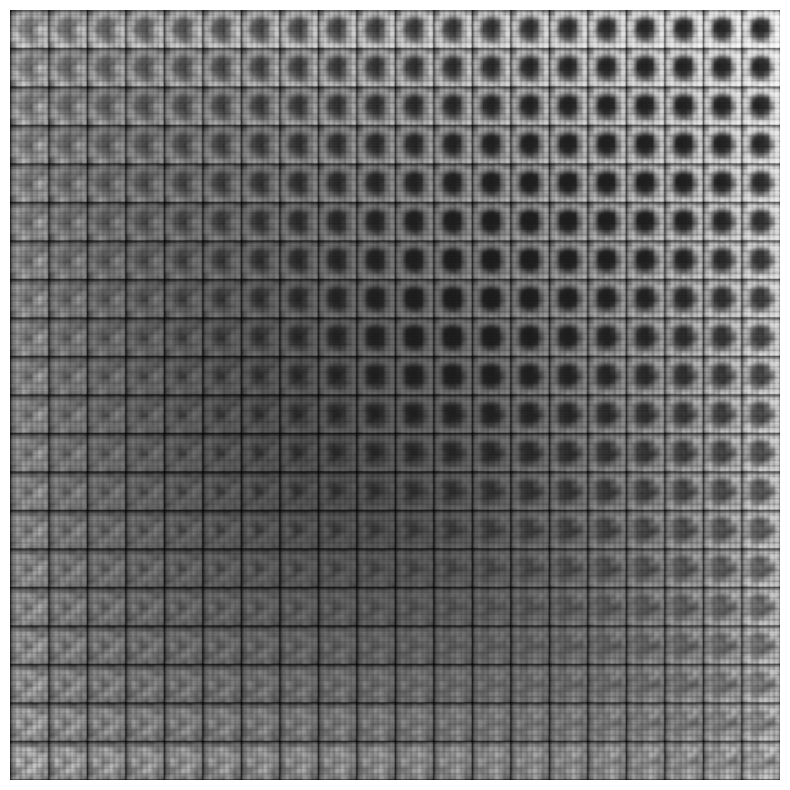

...

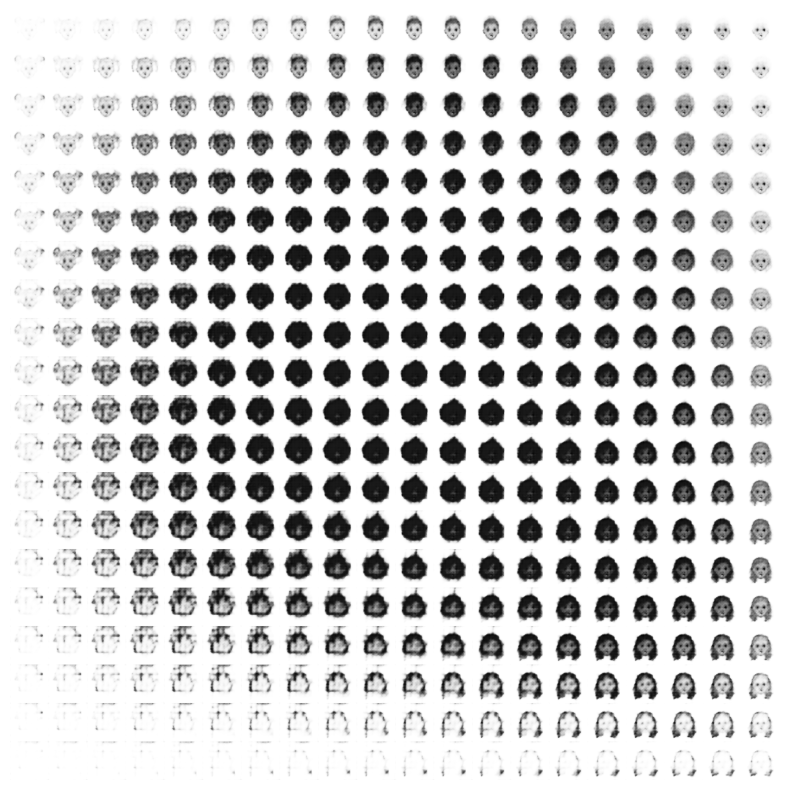

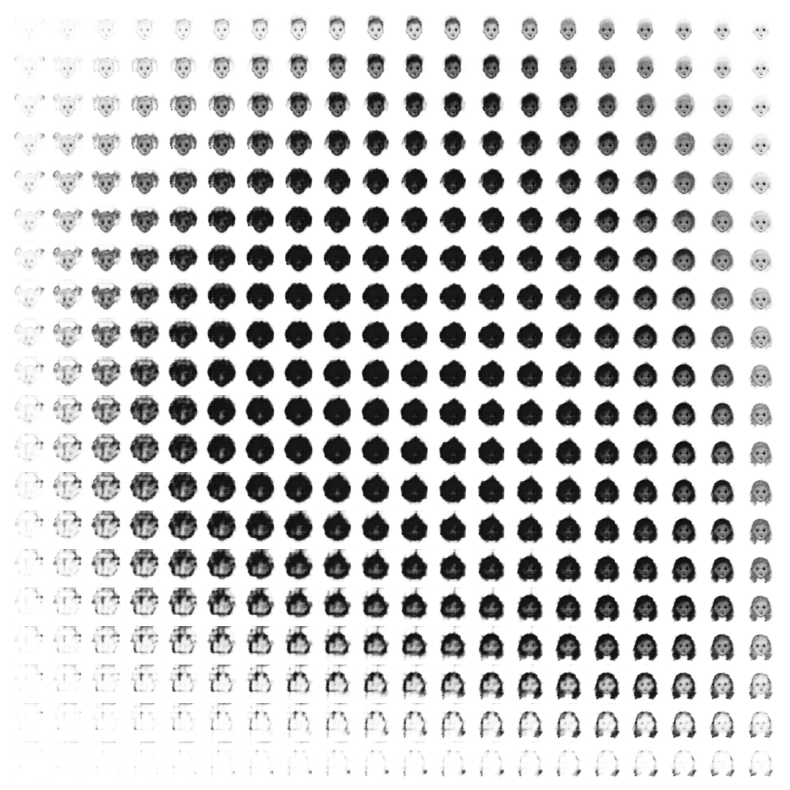

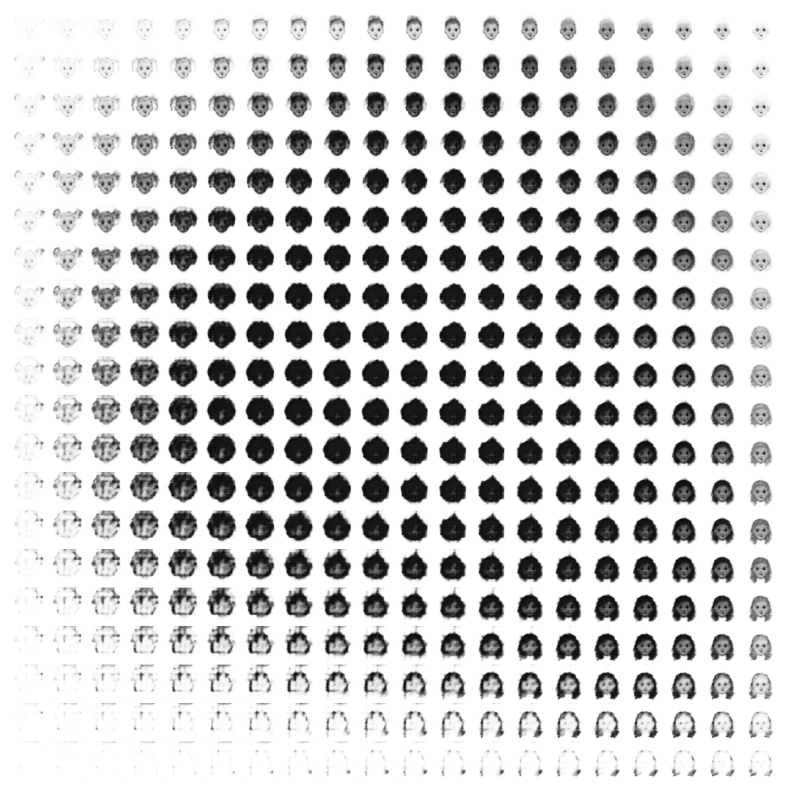

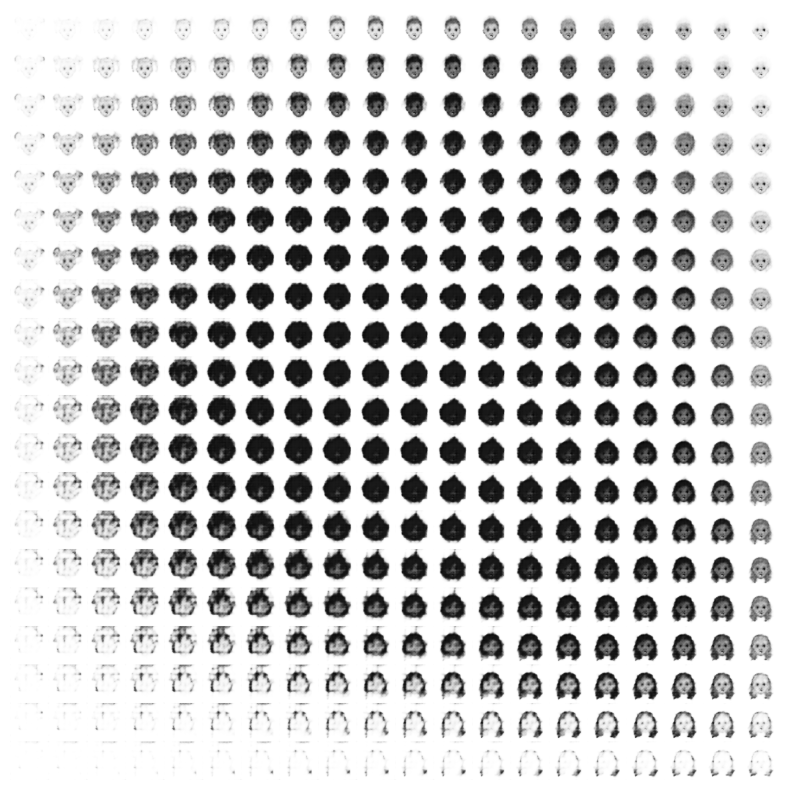

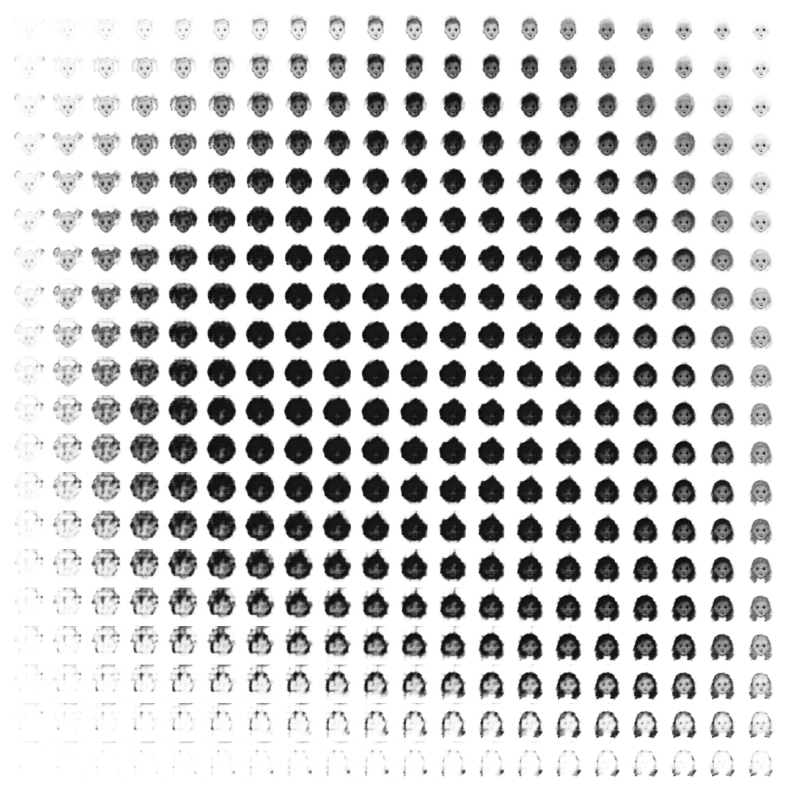

In [10]:
dagshub.init(repo_owner='DRACDARKTIME', repo_name='VA_cartoon', mlflow=True)
mlflow.set_experiment("LossFuntion_Modified_gamma_beta")
mlflow.start_run()
mlflow.log_params(params)

tf.config.run_functions_eagerly(True)
plot_latent_images(model=model, num_images_x=20, epoch=0)

optimizer = tf.keras.optimizers.Adam(params['epsilon'])

for epoch in range(1, params['epochs'] + 1):
    start_time = time.time()
    for idx, train_x in enumerate(train_ds):
        CVAE.train_step(model, train_x, optimizer)
        if epoch == 1 and idx % 75 == 0:
            plot_latent_images(model=model, num_images_x=20, epoch=epoch, first_epoch=True, f_ep_count=idx)          
    end_time = time.time()
    loss = tf.keras.metrics.Mean()
    for test_x in test_ds:
        loss(CVAE.compute_loss(model, test_x))
    elbo = -loss.result()
    mlflow.log_metric('elbo_loss_test', elbo, step = epoch)
    #display.clear_output(wait=False)
    print('Epoch: {}, Test set ELBO: {}, time elapse for current epoch: {}'
        .format(epoch, elbo, end_time - start_time))
    if epoch != 1:
        plot_latent_images(model=model, num_images_x= 20, epoch=epoch)
mlflow.tensorflow.log_model(model, 'model')        
mlflow.end_run()

In [11]:
#mlflow.end_run()

In [12]:
import os 

In [16]:
name_gif = f'grid_modified_gamma={params["gamma"]}_beta={params["beta"]}_epoch={params["epochs"]}.gif'
anim_file = path.data_created_dir(name_gif)
with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob(os.path.join(path.data_created_dir(),'tf_grid*.png'))
    filenames = sorted(filenames)
    for filename in filenames:
        #print(filename)
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)
for file in filenames:
    os.remove(file)

/tmp/ipykernel_3676/2787736416.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipykernel_3676/2787736416.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [18]:
name_model = f'model_modified_gamma={params["gamma"]}_beta={params["beta"]}_epochs={params["epochs"]}.weights.h5'
path_models = path.models_dir(name_model)

In [19]:
# Guardar los pesos del modelo
model.save_weights(path_models)


In [20]:
model.load_weights(path_models)

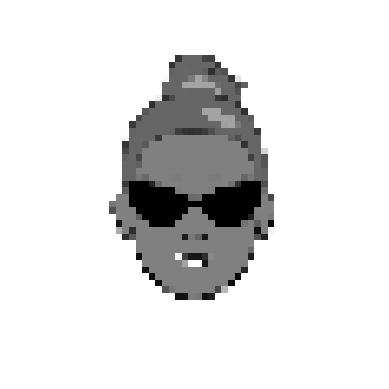

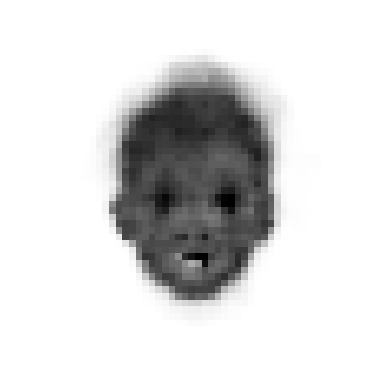

In [21]:
for img in test_ds:
    mean, logvar = model.encode(img)
    z = model.reparameterize(mean, logvar)
    generated_image = model.decode(z, apply_sigmoid=True)
    num_img = 10
    plt.imshow(img[num_img], cmap='gray')
    plt.axis('off')
    plt.show()

    plt.imshow(generated_image[num_img].numpy().squeeze(), cmap='gray')
    plt.axis('off')
    plt.show()
    break